<center> <span style="font-family:newtimeroman"> <span style="padding:300px;display:fill;border-radius:250px 250px;background-color:#D72A2B;font-size:160%;font-weight: 600;color:#F2ECC6;overflow:hidden;"> 5.5. Mini Batch K-means Clusteringㅤ</span>

<div style="border-radius:15px;border:#B71C1B solid;background-color:#F2ECC6; padding:20px; font-size:15px">
    
### ✍️Mini Batch K-means Clustering

**Mini Batch K-means clustering** is a variation of the traditional K-means clustering algorithm that is designed to handle large datasets efficiently. In traditional k-means, all data points are used in each iteration to calculate the centroids of each cluster, making it computationally expensive for large datasets. In Mini Batch k-means, a small random subset, or mini-batch, of the data is used in each iteration to update the centroids, which reduces the computational complexity and makes it faster than the traditional K-means. The algorithm randomly selects a mini-batch of data points and assigns them to the nearest cluster centroid, updates the centroids, and repeats the process until convergence. The convergence rate of Mini Batch k-means may be slower than traditional k-means, but it can be compensated by running the algorithm for a longer period or adjusting the learning rate. 

In [123]:
# Calculate silhouette coefficient and calinski harabasz coefficient
silhouette_coef = []
for k in range(2,11):
    mbkmeans = MiniBatchKMeans(n_clusters=k, random_state=42)
    labels = mbkmeans.fit_predict(scaled_col)
    score = silhouette_score(scaled_col, labels)
    silhouette_coef.append(score)

calinski_harabasz_coef = []
for k in range(2,11):
    mbkmeans = MiniBatchKMeans(n_clusters=k, random_state=42)
    mbkmeans.fit(scaled_col)
    score = calinski_harabasz_score(scaled_col, mbkmeans.predict(scaled_col))
    calinski_harabasz_coef.append(score)

In [124]:
# Create a dataframe to store the scores
scores_mbkmeans = pd.DataFrame({'k': range(2,11),
'Silhouette Score': silhouette_coef,
'Calinski-Harabasz Score': calinski_harabasz_coef})

# Find the best k for each score
best_k_silhouette = scores_mbkmeans.loc[scores_mbkmeans['Silhouette Score'].idxmax(), 'k']
best_k_calinski_harabaz = scores_mbkmeans.loc[scores_mbkmeans['Calinski-Harabasz Score'].idxmax(), 'k']

In [125]:
print("\nScores for Different Numbers of Clusters:")
scores_mbkmeans.style.background_gradient(cmap=cmap).set_properties(**{'font-family': 'Segoe UI'}).hide_index()


Scores for Different Numbers of Clusters:


k,Silhouette Score,Calinski-Harabasz Score
2,0.172228,1412.808318
3,0.190103,1488.757237
4,0.180396,1475.459069
5,0.157656,1191.196449
6,0.164684,1270.946373
7,0.147770,1101.245836
8,0.158025,1105.841685
9,0.211456,1149.602916
10,0.200145,1098.781556


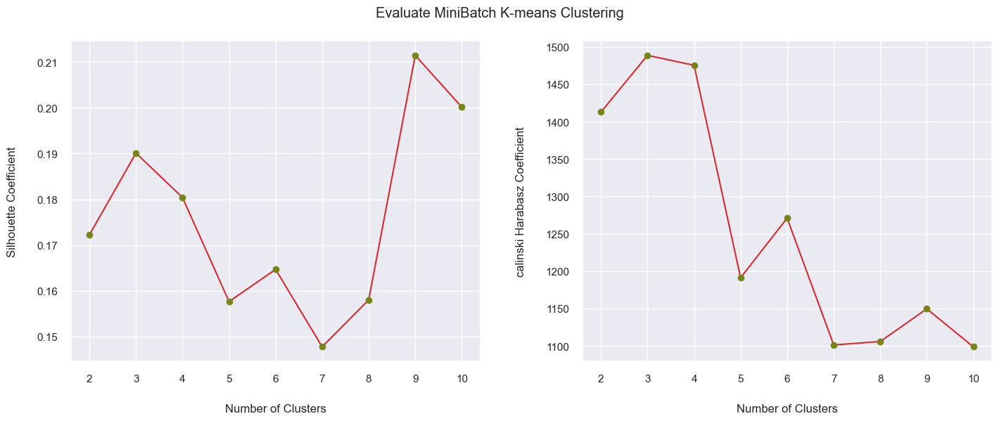

In [126]:
# Visualize plots of silhouette and calinski harabasz scores for MiniBatchKMeans models
plot_evaluation(silhouette_coef, calinski_harabasz_coef, 'MiniBatch K-means')

In [127]:
# Best k for each coef
print(f"\n▪️Best k for Silhouette Coefficient: {best_k_silhouette}")
print(f"▪️Best k for Calinski-Harabasz Coefficient: {best_k_calinski_harabaz}")


▪️Best k for Silhouette Coefficient: 9
▪️Best k for Calinski-Harabasz Coefficient: 3


#### 🌴Using Hybrid Score to Find the Best k

In [128]:
def select_k(scaled_col):
    silhouette_scores = []
    calinski_scores = []
    k_values = range(2, 11)

    for k in k_values:
        # Perform clustering using KMeans algorithm
        mbkmeans = MiniBatchKMeans(n_clusters=k, random_state=42)
        labels = mbkmeans.fit_predict(scaled_col)

        # Calculate Silhouette Score
        silhouette_scores.append(silhouette_score(scaled_col, labels))

        # Calculate Calinski-Harabasz Score
        calinski_scores.append(calinski_harabasz_score(scaled_col, labels))

    hybrid_scores = np.sqrt(np.multiply(silhouette_scores, calinski_scores))
    best_k = k_values[np.argmax(hybrid_scores)]
    return best_k

In [129]:
best_k = select_k(scaled_col)
print("\n✅Best value of k:", best_k)


✅Best value of k: 3


#### 🌴Implement Mini Batch k-means with the Best Number of Clusters

In [130]:
# Run mbkmeans clustering with n_clusters=3
mbkmeans = MiniBatchKMeans(n_clusters=best_k, random_state=42).fit(scaled_col)

# Get the coordinates of the centroids of the three clusters
centroids = mbkmeans.cluster_centers_

# Convert the centroids array to a DataFrame and assign column names
centroids = pd.DataFrame(centroids, columns=scaled_col.columns)
centroids

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,-0.388936,-0.165862,-0.020301,-0.050874,0.045473,-0.381620,0.329339,0.079509,0.277793,-0.500906,-0.386287,0.035652,-0.162375,-0.168757,-0.143817,0.194251,0.057613
1,0.693608,0.314367,-0.323615,-0.231095,-0.340701,0.788095,-0.760593,-0.356397,-0.641988,1.073470,0.849594,-0.397800,0.170757,0.128234,0.258917,-0.428614,-0.107339
2,1.608415,0.492498,3.735610,4.041607,1.407308,-0.274862,1.203095,2.248875,1.188768,-0.485015,-0.295773,3.116159,1.381568,1.259110,0.967142,0.011671,0.350657


In [131]:
# Get the cluster labels assigned to each data point by mbkmeans
pred = mbkmeans.labels_

# Convert the centroids from scaled values to the original scale
real_centroids = scaler.inverse_transform(centroids)

# Convert the centroids array to a DataFrame and assign column names
real_centroids = pd.DataFrame(real_centroids, columns=df.columns)
real_centroids

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,755.090612,0.838076,959.941737,508.059675,452.236345,178.645506,0.622581,0.226200,0.474881,0.034899,0.612819,15.597694,3903.628080,1244.784405,509.511189,0.210549,11.594967
1,3008.369971,0.951788,311.878547,208.913993,103.008306,2631.711150,0.185151,0.096157,0.109333,0.349965,9.047224,4.823300,5115.767561,2104.574407,1448.999338,0.028365,11.374416
2,4912.511302,0.993966,8984.851836,7301.070499,1683.781336,402.534487,0.973252,0.873384,0.836929,0.038079,1.230543,92.170338,9521.439060,5378.469078,3101.127606,0.157146,11.986784


#### 🌴Evaluation of the performance of the MiniBatch K-means model

In [132]:
# Calculate scores
silhouette = silhouette_score(scaled_col, pred)
calinski = calinski_harabasz_score(scaled_col, pred)

# Create a DataFrame with the scores
mbkm_scores = pd.DataFrame({'Silhouette Score': [silhouette], 'Calinski-Harabasz Score': [calinski]}, index=['MiniBatch K-means'])
mbkm_scores

,Silhouette Score,Calinski-Harabasz Score
MiniBatch K-means,0.190103,1488.757237


#### 🌴Addition of Cluster Column to the Data frame

In [133]:
mbkmeans_clustered_df = pd.concat([df, pd.DataFrame(pred, columns=['MiniBatch K-means Cluster'])], axis = 1)
mbkmeans_clustered_df.head(10).style.set_properties(**{'background-color': '#F2ECC6'}, subset=['MiniBatch K-means Cluster'])

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,MiniBatch K-means Cluster
0,40.900749,0.818182,95.400000,0.000000,95.400000,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.000000,201.802084,139.509787,0.000000,12,0
1,3202.467416,0.909091,0.000000,0.000000,0.000000,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.000000,4103.032597,1072.340217,0.222222,12,1
2,2495.148862,1.000000,773.170000,773.170000,0.000000,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.000000,622.066742,627.284787,0.000000,12,0
3,1666.670542,0.636364,1499.000000,1499.000000,0.000000,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.000000,0.000000,312.452292,0.000000,12,0
4,817.714335,1.000000,16.000000,16.000000,0.000000,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.000000,678.334763,244.791237,0.000000,12,0
5,1809.828751,1.000000,1333.280000,0.000000,1333.280000,0.000000,0.666667,0.000000,0.583333,0.000000,0,8,1800.000000,1400.057770,2407.246035,0.000000,12,0
6,627.260806,1.000000,7091.010000,6402.630000,688.380000,0.000000,1.000000,1.000000,1.000000,0.000000,0,64,13500.000000,6354.314328,198.065894,1.000000,12,2
7,1823.652743,1.000000,436.200000,0.000000,436.200000,0.000000,1.000000,0.000000,1.000000,0.000000,0,12,2300.000000,679.065082,532.033990,0.000000,12,0
8,1014.926473,1.000000,861.490000,661.490000,200.000000,0.000000,0.333333,0.083333,0.250000,0.000000,0,5,7000.000000,688.278568,311.963409,0.000000,12,0
9,152.225975,0.545455,1281.600000,1281.600000,0.000000,0.000000,0.166667,0.166667,0.000000,0.000000,0,3,11000.000000,1164.770591,100.302262,0.000000,12,0


In [134]:
mbkmeans_clustered_df.shape

(8949, 18)

#### 🌴Size of the Clusters

In [135]:
MiniBatch_clust_sizes = mbkmeans_clustered_df.groupby('MiniBatch K-means Cluster').size().to_frame()
MiniBatch_clust_sizes.columns = ["MiniBatch K-means Size"]
MiniBatch_clust_sizes

,MiniBatch K-means Size
MiniBatch K-means Cluster,
0,5736
1,2841
2,372


#### 🌴Distribution of Data Points by Cluster

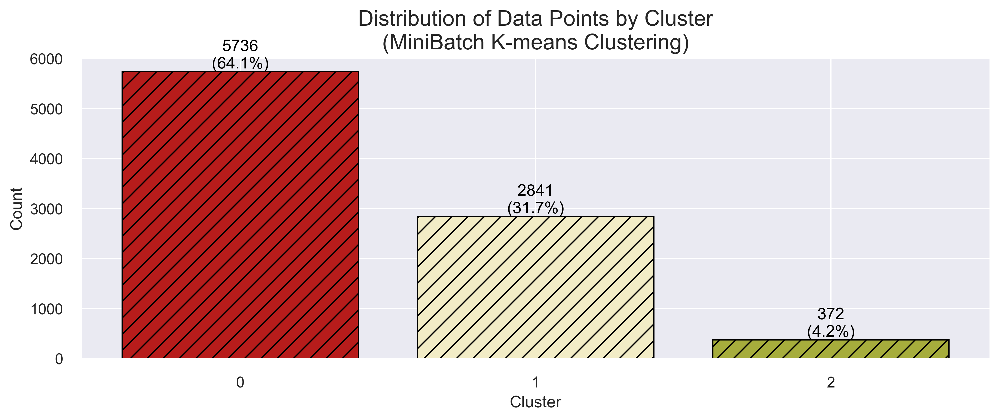

In [136]:
# Distribution of Data Points by Cluster
counts = mbkmeans_clustered_df['MiniBatch K-means Cluster'].value_counts()
labels = counts.index.tolist()
sizes = counts.tolist()

# Calculate percentages and counts
total = sum(sizes)
percentages = [(size / total) * 100 for size in sizes]
counts = [f'{size}\n({percentages[i]:.1f}%)' for i, size in enumerate(sizes)]

# Create the bar plot
plt.figure(figsize=(12, 4))
colors = ["#B71C1B","#F2ECC6","#A6AD3C"]
bars = plt.bar(labels, sizes, color=colors, edgecolor='black', linewidth=1, hatch='//')
plt.xticks(range(len(labels)), [str(i) for i in range(len(labels))])

# Add counts to bars
for i, bar in enumerate(bars):
    plt.text(bar.get_x() + bar.get_width() / 2, bar.get_height() + 1,
             counts[i], ha='center', va='bottom', color='black', fontsize=12)

# Set the axis labels and title
plt.xlabel('Cluster', fontsize= 12)
plt.ylabel('Count', fontsize= 12)
plt.title('Distribution of Data Points by Cluster\n(MiniBatch K-means Clustering)', fontsize= 16)
plt.show()

#### 🌴Distribution of data in different clusters

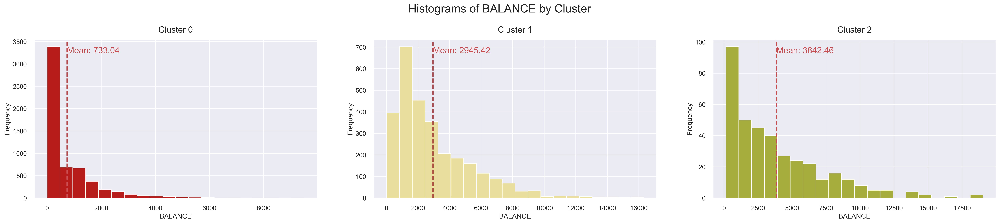

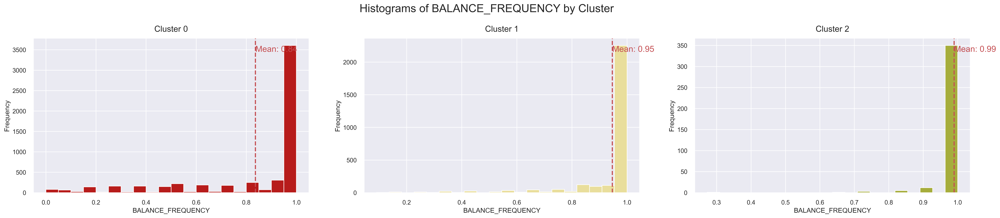

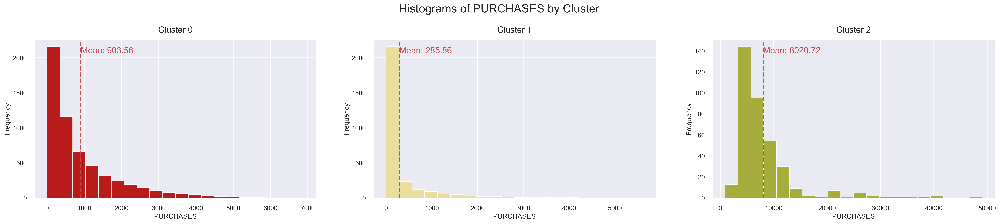

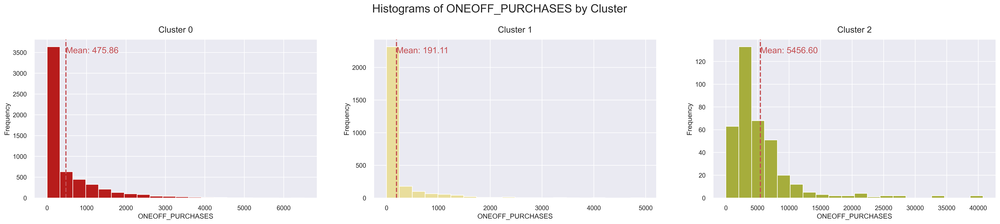

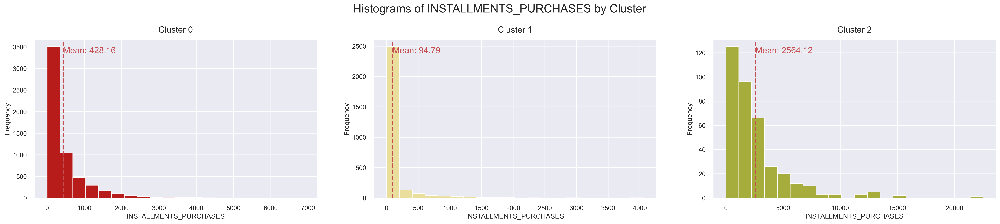

...

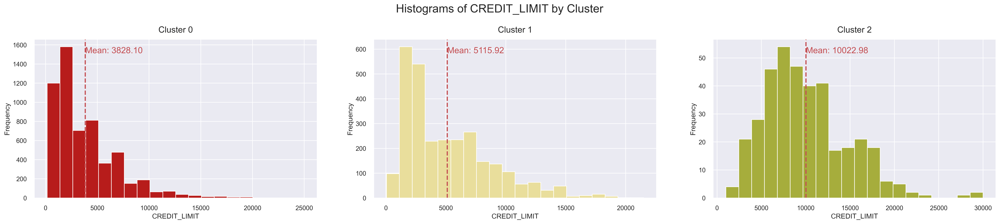

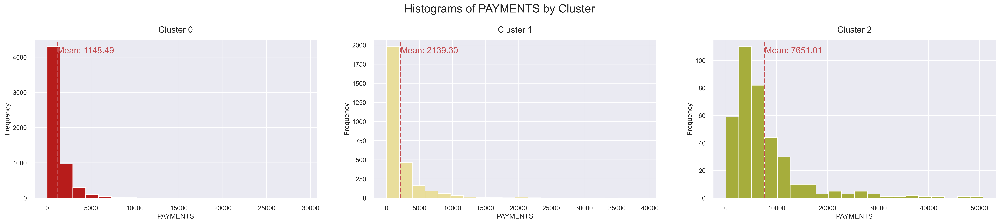

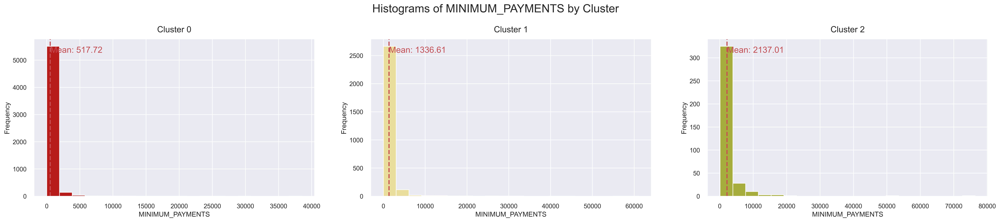

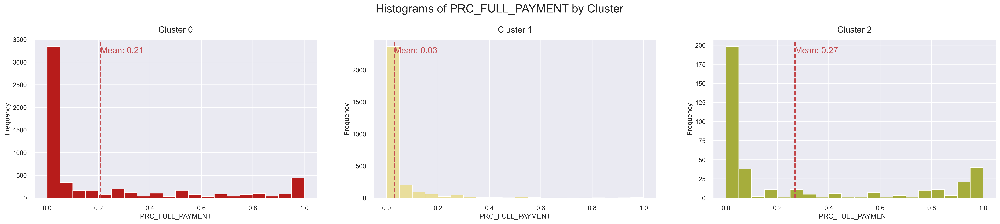

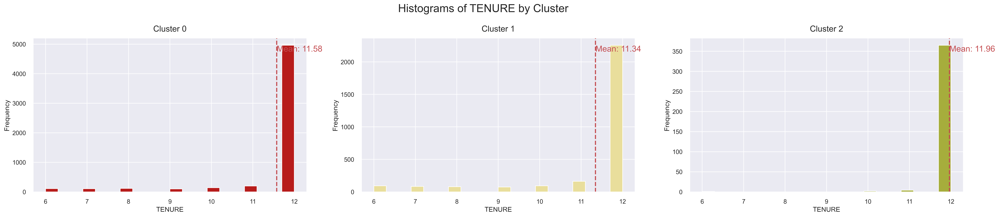

In [137]:
# Define custom color palette
colors = ["#B71C1B",'#e9de9c',"#A6AD3C"]

# Plot the histogram of various clusters
for col in df.columns:
    # Create a figure with subplots for each cluster
    fig, axes = plt.subplots(1, 3, figsize=(30,5))
    # Set the figure title
    fig.suptitle(f'Histograms of {col} by Cluster', fontsize=20, y=1.05)
    for j in range(3):
        # Select data for the current cluster and column
        cluster = mbkmeans_clustered_df[mbkmeans_clustered_df['MiniBatch K-means Cluster'] == j][col]
        # Plot the histogram for the current cluster and column
        counts, bins, patches = axes[j].hist(cluster, bins=20, color=colors[j])
        # Calculate and add the mean line to the histogram
        mean = cluster.mean()
        axes[j].axvline(mean, color='r', linestyle='dashed', linewidth=2)
        ymin, ymax = axes[j].get_ylim()
        axes[j].text(mean, ymax*0.95, f"Mean: {mean:.2f}", ha='left', va='top', color='r', fontsize=15)
        # Set the subplot title and axis labels
        axes[j].set_title(f'Cluster {j}', fontsize=15, y=1.02)
        axes[j].set_xlabel(col, fontsize=12)
        axes[j].set_ylabel('Frequency', fontsize=12)
    # Adjust the spacing between subplots and display the plot
    plt.subplots_adjust(wspace=0.2)
    plt.show()

#### 🌴Cluster Analysis and customers segmentation (Scaled data)

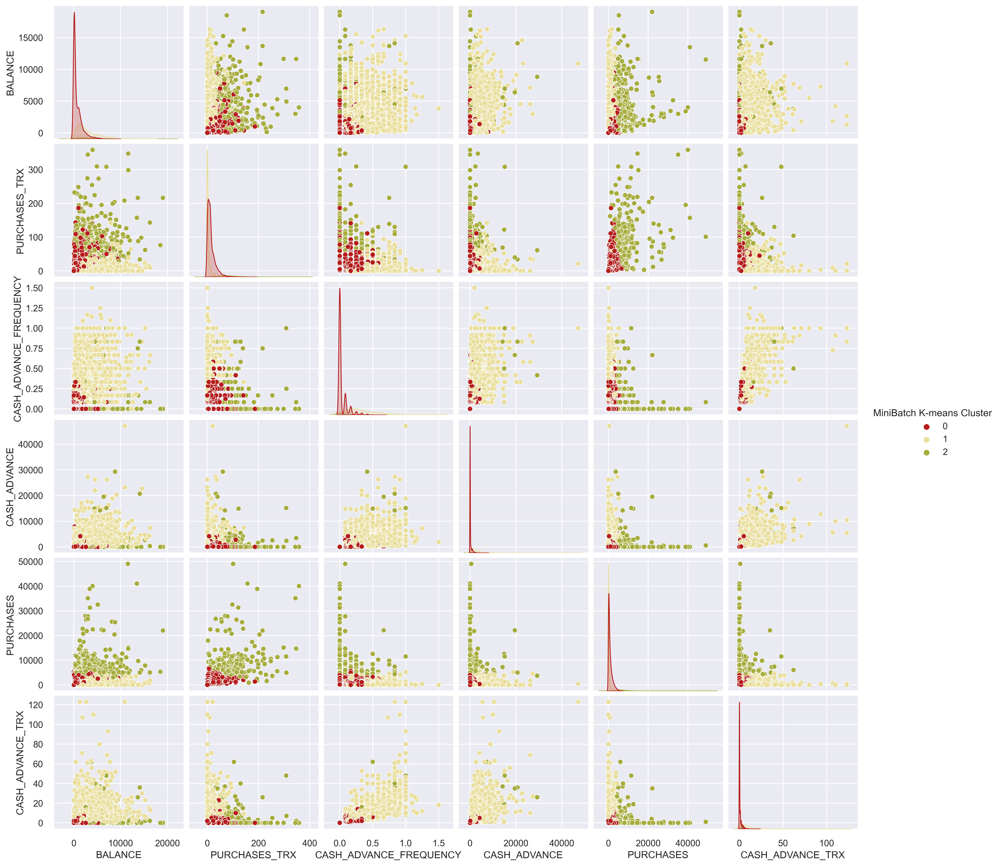

In [138]:
# Pairplot (Scaled data)
colors = ["#B71C1B",'#e9de9c',"#A6AD3C"]

important_variables = ['BALANCE', 'PURCHASES_TRX', 'CASH_ADVANCE_FREQUENCY', 'CASH_ADVANCE', 'PURCHASES', 'CASH_ADVANCE_TRX', 'MiniBatch K-means Cluster']

sns.set_style('darkgrid')
sns.pairplot(mbkmeans_clustered_df[important_variables], hue='MiniBatch K-means Cluster', palette=colors)
plt.show()

In [139]:
# Summarizing the average values of each feature within each cluster
avg_df = mbkmeans_clustered_df.groupby(['MiniBatch K-means Cluster'], as_index=False).mean()
avg_df.style.background_gradient(cmap=cmap).set_properties(**{'font-family': 'Segoe UI'}).hide_index()

MiniBatch K-means Cluster,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,733.038111,0.835994,903.563271,475.857502,428.156424,171.389170,0.618317,0.223334,0.467705,0.035665,0.620293,14.940551,3828.095697,1148.485520,517.720513,0.207725,11.575314
1,2945.417305,0.946172,285.863252,191.109173,94.789866,2620.113687,0.171964,0.086890,0.101452,0.343122,8.652235,4.166139,5115.917357,2139.296293,1336.614086,0.029726,11.343893
2,3842.457361,0.989443,8020.717312,5456.598602,2564.118710,897.522411,0.950049,0.763702,0.781541,0.080621,2.518817,91.715054,10022.983871,7651.007323,2137.014978,0.268245,11.962366


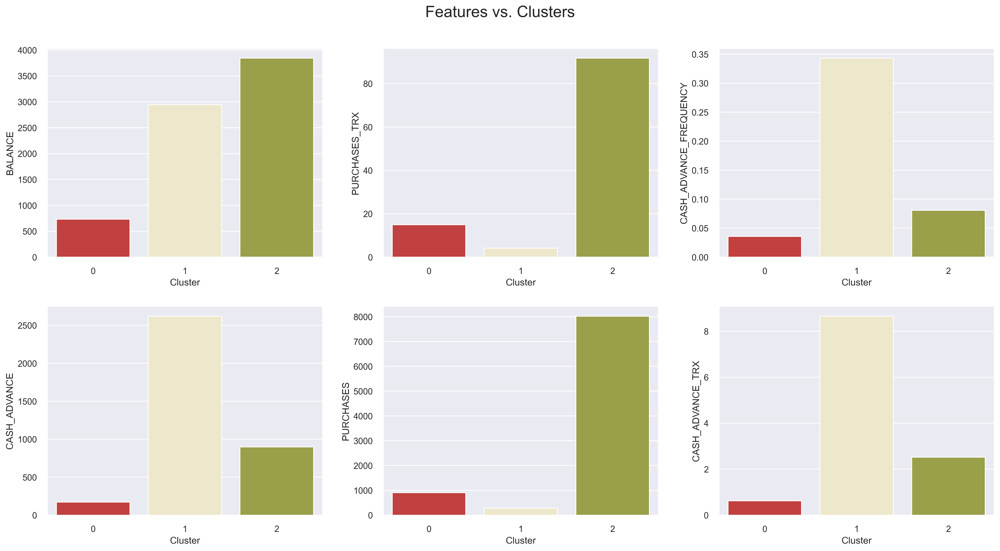

In [140]:
custom_colors = ["#D72A2B", "#F2ECC6", "#A6AD3C"]

fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(18, 10))
for i, col in enumerate(['BALANCE', 'PURCHASES_TRX', 'CASH_ADVANCE_FREQUENCY', 'CASH_ADVANCE', 'PURCHASES', 'CASH_ADVANCE_TRX']):
    sns.barplot(x='MiniBatch K-means Cluster', y=col, data=avg_df, ax=axes[i//3][i%3], palette=custom_colors)
    axes[i//3][i%3].set_xlabel('Cluster')
    axes[i//3][i%3].set_ylabel(col)
plt.suptitle('Features vs. Clusters', fontsize=20)
fig.tight_layout(pad=2.0)
plt.show()

In [141]:
db_g = pd.DataFrame(mbkmeans_clustered_df.groupby(['MiniBatch K-means Cluster','TENURE'])['TENURE'].count())
db_g.T.style.background_gradient(cmap=cmap).set_properties(**{'font-family': 'Segoe UI'})

#### 🌴Distribution of the most important features after Clustering

In [142]:
features = ['BALANCE', 'PURCHASES_TRX', 'CASH_ADVANCE_FREQUENCY', 'CASH_ADVANCE', 'PURCHASES', 'CASH_ADVANCE_TRX']

for feature in features:
    fig = px.histogram(mbkmeans_clustered_df, x=feature, color='MiniBatch K-means Cluster', template=temp,
                       marginal='box', opacity=0.7, nbins=50, color_discrete_sequence=[colors_mix[2],colors_mix[7]],
                       barmode='group', histfunc='count')
    
    fig.update_layout(
        font_family='monospace',
        title=dict(text=f'Distribution of {feature} After Clustering', x=0.5, y=0.95,
                   font=dict(color=colors_dark[2], size=20)),
        xaxis_title_text=feature,
        yaxis_title_text='Count',
        legend=dict(x=1, y=0.96, bordercolor=colors_dark[4], borderwidth=0, tracegroupgap=5),
        bargap=0.3,
    )
    fig.show()

#### 🌴Cluster Analysis and customers segmentation (Orginal data)

In [143]:
# Create an instance of the MiniBatchKMeans Clustering class with the specified parameters
mbkmeans = MiniBatchKMeans(n_clusters=3, random_state=42)

# Fit the clustering model to the data and predict the cluster labels for each observation
pred = mbkmeans.fit_predict(df)

# Create a copy of the original DataFrame to avoid modifying it directly
df_mbkmeans = df.copy()

# Add a new column to the DataFrame with the predicted cluster labels
df_mbkmeans["MiniBatch K-means Cluster"] = pred

# Sort the DataFrame by the cluster labels to group similar observations together
df_mbkmeans = df_mbkmeans.sort_values(by='MiniBatch K-means Cluster')

# Convert the cluster labels to categorical variables for easier analysis
df_mbkmeans['MiniBatch K-means Cluster'] = df_mbkmeans['MiniBatch K-means Cluster'].astype('category')

In [144]:
df_mbkmeans.head(10).style.set_properties(**{'background-color': '#F2ECC6'}, subset=['MiniBatch K-means Cluster'])

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,MiniBatch K-means Cluster
0,40.900749,0.818182,95.400000,0.000000,95.400000,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.000000,201.802084,139.509787,0.000000,12,0
5932,1476.166090,1.000000,0.000000,0.000000,0.000000,1429.734958,0.000000,0.000000,0.000000,0.333333,6,0,3000.000000,2644.305670,492.497922,0.000000,12,0
5931,1679.952713,1.000000,585.390000,585.390000,0.000000,0.000000,0.750000,0.750000,0.000000,0.000000,0,11,1700.000000,523.910288,1315.479892,0.000000,12,0
5930,170.019011,0.500000,266.600000,266.600000,0.000000,1199.729121,0.166667,0.166667,0.000000,0.166667,3,1,2500.000000,293.055707,88.589314,0.000000,6,0
5929,116.418751,1.000000,1176.000000,0.000000,1176.000000,0.000000,1.000000,0.000000,1.000000,0.000000,0,12,2150.000000,1083.783994,1364.816672,0.666667,12,0
5927,0.000000,0.000000,9.280000,0.000000,9.280000,0.000000,0.250000,0.000000,0.250000,0.000000,0,3,5000.000000,0.000000,312.452292,0.000000,12,0
5926,3136.079106,1.000000,555.000000,0.000000,555.000000,1728.321044,1.000000,0.000000,0.916667,0.083333,4,12,3500.000000,1045.129438,780.780114,0.000000,12,0
5925,1700.753811,1.000000,0.000000,0.000000,0.000000,624.480873,0.000000,0.000000,0.000000,0.500000,9,0,2000.000000,418.596666,434.688783,0.000000,12,0
5924,325.038037,1.000000,512.160000,105.000000,407.160000,0.000000,0.833333,0.083333,0.750000,0.000000,0,13,2500.000000,567.449456,238.252068,0.000000,12,0
5923,1082.436807,1.000000,0.000000,0.000000,0.000000,1835.406271,0.000000,0.000000,0.000000,0.250000,7,0,1500.000000,2094.304543,258.977488,0.000000,12,0


In [145]:
df_mbkmeans.shape

(8949, 18)

#### 🌴Distribution of Data Points by Cluster

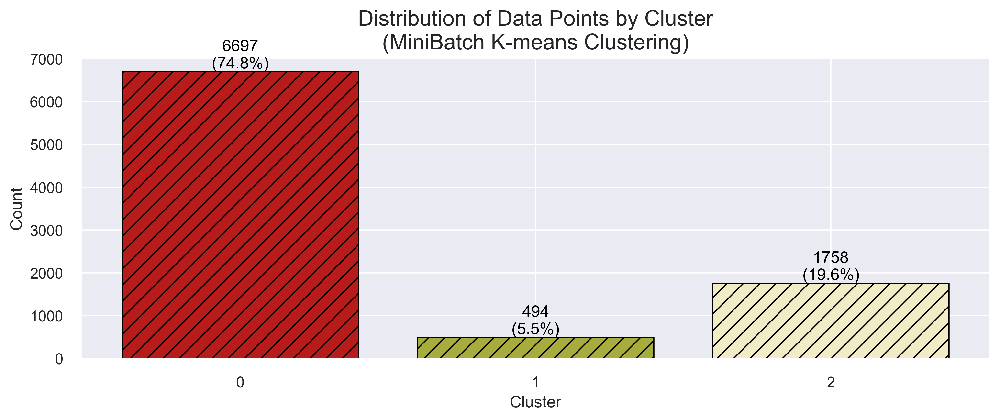

In [146]:
# Distribution of Data Points by Cluster
counts = df_mbkmeans['MiniBatch K-means Cluster'].value_counts()
labels = counts.index.tolist()
sizes = counts.tolist()

# Calculate percentages and counts
total = sum(sizes)
percentages = [(size / total) * 100 for size in sizes]
counts = [f'{size}\n({percentages[i]:.1f}%)' for i, size in enumerate(sizes)]

# Create the bar plot
plt.figure(figsize=(12, 4))
colors = ["#B71C1B","#F2ECC6","#A6AD3C"]
bars = plt.bar(labels, sizes, color=colors, edgecolor='black', linewidth=1, hatch='//')
plt.xticks(range(len(labels)), [str(i) for i in range(len(labels))])

# Add counts to bars
for i, bar in enumerate(bars):
    plt.text(bar.get_x() + bar.get_width() / 2, bar.get_height() + 1,
             counts[i], ha='center', va='bottom', color='black', fontsize=12)

# Set the axis labels and title
plt.xlabel('Cluster', fontsize= 12)
plt.ylabel('Count', fontsize= 12)
plt.title('Distribution of Data Points by Cluster\n(MiniBatch K-means Clustering)', fontsize= 16)
plt.show()

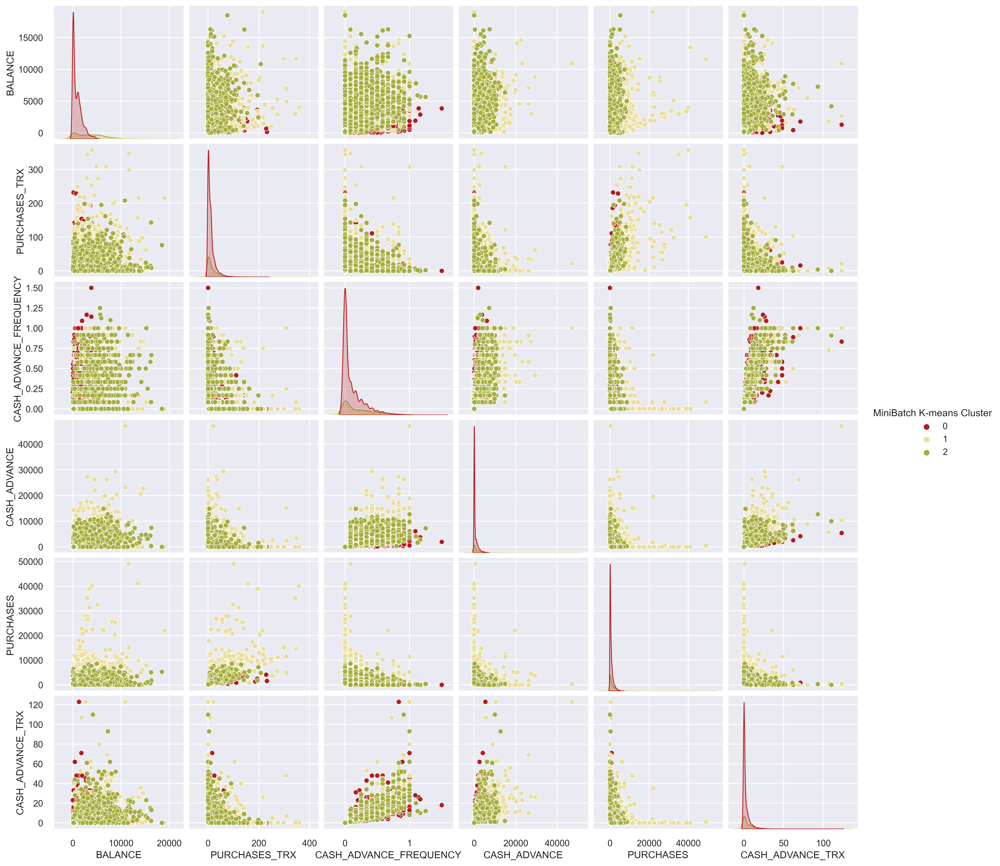

In [147]:
# Pairplot (Orginal data)
colors = ["#B71C1B",'#e9de9c',"#A6AD3C"]

sns.set_style('darkgrid')
sns.pairplot(df_mbkmeans[important_variables], hue='MiniBatch K-means Cluster', palette=colors)
plt.show()

In [148]:
# Plot of clusters
fig = px.scatter(df_mbkmeans, x="PURCHASES", y="CASH_ADVANCE_TRX", color="MiniBatch K-means Cluster", 
                 color_discrete_sequence=px.colors.qualitative.Prism)
fig.update_traces(marker=dict(size=11, opacity=0.75, line=dict(width=1, color='#F7F7F7')))
fig.update_layout(template=temp, title="MiniBatch K-means Cluster Profiles,<br>PURCHASES vs. CASH_ADVANCE_TRX", 
                  width=700, legend_title='MiniBatch K-means Cluster',
                  xaxis=dict(title='PURCHASES', showline=True, zeroline=False), 
                  yaxis=dict(title='CASH_ADVANCE_TRX', ticksuffix='k', showline=True))
fig.show()